In [ ]:
import random
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt

In [ ]:
means = np.random.normal(0, 1, 10)

In [ ]:
probs = [np.random.normal(mean,1,1000) for mean in means]

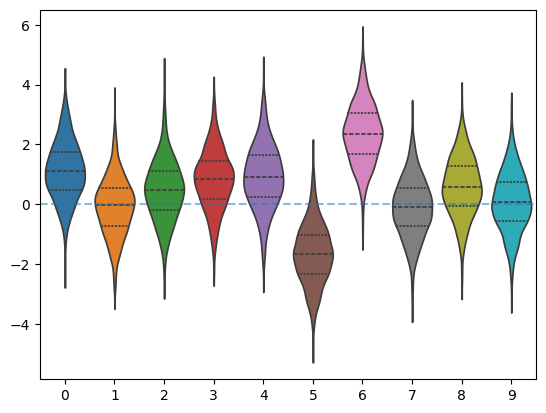

In [15]:
sns.violinplot(data=probs, inner="quart")
plt.axhline(0, alpha=0.5, ls="--")

In [52]:
class Model():
    def __init__(self, mode=None):
        self.averages = np.zeros(10)
        self.standard_averages = np.zeros(10)
        self.epsilon = 0.1
        self.n = 1

    def chosen_bandit(self):
        res = np.argwhere(self.averages == np.amax(self.averages))
        if len(res) == len(self.averages):
            return np.random.choice(range(10))
        weights = [(1-self.epsilon)/len(res) if [i] in res else self.epsilon/(len(self.averages) - len(res)) for i in range(10)]
        self.n += 1
        return np.random.choice(range(10), p=weights)

    def update_averages(index, value):
        self.averages[index] -= self.epsilon*(value - self.averages[index])
        self.standard_averages[index] -= self.eps

In [53]:
model = Model()
print(model.chosen_bandit())

0


In [79]:
# Dynamic Programming and Value Iteration
terminal_states = [0, 15]
states = list(range(16))
actions = [+4, -4, -1, +1]
values = [0]*16
mdp = {
    state: {
        action: (0.25, state, 0) for action in actions
    }
    if state in terminal_states
    else {
        action: (0.25, state + action*(0 <= state + action <= 15), -1) for action in actions
    }
    for state in states
}
epsilon = 10^(-2)
gamma = 0.9
mdp

{0: {4: (0.25, 0, 0), -4: (0.25, 0, 0), -1: (0.25, 0, 0), 1: (0.25, 0, 0)},
 1: {4: (0.25, 5, -1), -4: (0.25, 1, -1), -1: (0.25, 0, -1), 1: (0.25, 2, -1)},
 2: {4: (0.25, 6, -1), -4: (0.25, 2, -1), -1: (0.25, 1, -1), 1: (0.25, 3, -1)},
 3: {4: (0.25, 7, -1), -4: (0.25, 3, -1), -1: (0.25, 2, -1), 1: (0.25, 4, -1)},
 4: {4: (0.25, 8, -1), -4: (0.25, 0, -1), -1: (0.25, 3, -1), 1: (0.25, 5, -1)},
 5: {4: (0.25, 9, -1), -4: (0.25, 1, -1), -1: (0.25, 4, -1), 1: (0.25, 6, -1)},
 6: {4: (0.25, 10, -1),
  -4: (0.25, 2, -1),
  -1: (0.25, 5, -1),
  1: (0.25, 7, -1)},
 7: {4: (0.25, 11, -1),
  -4: (0.25, 3, -1),
  -1: (0.25, 6, -1),
  1: (0.25, 8, -1)},
 8: {4: (0.25, 12, -1),
  -4: (0.25, 4, -1),
  -1: (0.25, 7, -1),
  1: (0.25, 9, -1)},
 9: {4: (0.25, 13, -1),
  -4: (0.25, 5, -1),
  -1: (0.25, 8, -1),
  1: (0.25, 10, -1)},
 10: {4: (0.25, 14, -1),
  -4: (0.25, 6, -1),
  -1: (0.25, 9, -1),
  1: (0.25, 11, -1)},
 11: {4: (0.25, 15, -1),
  -4: (0.25, 7, -1),
  -1: (0.25, 10, -1),
  1: (0.25, 12, -1

In [80]:
def display_matrix(array):
    for i in range(4):
        print(array[4*i: 4*(i+1)])

In [81]:
is_static = False
while not is_static:
    is_static = True
    for i in range(16):
        prev = values[i]
        values[i] = max([(action[2] + values[action[1]]) for key, action in mdp[i].items()])
        if values[i] != prev:
            is_static = False

In [82]:
display_matrix(values)

[0, -1, -2, -2]
[-1, -2, -3, -2]
[-2, -3, -2, -1]
[-2, -2, -1, 0]


In [110]:
# Car Rental Problem
states = []
for i in range(0, 21):
    for j in range(0, 21):
        states.append((i,j))

In [111]:
actions = list(range(-5, 6))
from math import exp

In [112]:
customer_probs_1 = []
customer_probs_2 = []
return_probs_1 = []
return_probs_2 = []

In [113]:
def fill_probs(n, expected):
    result = []
    total_prob = 0
    i_factorial = 1
    lambda_power = 1
    e_power = exp(-expected)
    for i in range(n+1):
        probability = lambda_power*e_power/i_factorial
        total_prob += probability
        result.append(probability)
        lambda_power *= expected
        i_factorial *= (i+1)
    result.append(1-total_prob)
    return result

In [114]:
customer_probs_1 = fill_probs(20, 3)
customer_probs_2 = fill_probs(20, 4)
return_probs_1 = fill_probs(19, 3)
return_probs_2 = fill_probs(19, 2)
customer_probs_1

[0.049787068367863944,
 0.14936120510359183,
 0.22404180765538775,
 0.22404180765538775,
 0.16803135574154082,
 0.10081881344492448,
 0.05040940672246225,
 0.02160403145248382,
 0.008101511794681432,
 0.002700503931560477,
 0.0008101511794681432,
 0.00022095032167312998,
 5.5237580418282494e-05,
 1.2747133942680574e-05,
 2.7315287020029804e-06,
 5.46305740400596e-07,
 1.0243232632511176e-07,
 1.8076292880902075e-08,
 3.0127154801503463e-09,
 4.756919179184757e-10,
 7.135378768777135e-11,
 1.1790235454611775e-11]

In [115]:
for i in range(1, len(customer_probs_1)):
    customer_probs_1[i] += customer_probs_1[i-1]
    customer_probs_2[i] += customer_probs_2[i-1]
customer_probs_1

[0.049787068367863944,
 0.19914827347145578,
 0.42319008112684353,
 0.6472318887822313,
 0.8152632445237721,
 0.9160820579686966,
 0.9664914646911589,
 0.9880954961436427,
 0.9961970079383241,
 0.9988975118698846,
 0.9997076630493528,
 0.9999286133710259,
 0.9999838509514442,
 0.9999965980853869,
 0.9999993296140889,
 0.9999998759198293,
 0.9999999783521556,
 0.9999999964284485,
 0.999999999441164,
 0.999999999916856,
 0.9999999999882098,
 1.0]

In [ ]:
# mdp will follow the format - state: action: (p(s', a, s), s, Expected reward)

In [127]:
mdp = {}
lambda1 = 3
lambda2 = 4
ret_lambda1 = 3
ret_lambda2  = 2
for state in states:
    mdp[state] = {}
    possible_actions = [action for action in actions if 0 <= state[0] - action <= 20 and 0 <= state[1] + action <= 20]
    for action in possible_actions:
        mdp[state][action] = []
        init_state_1 = state[0] - action
        init_state_2 = state[1] + action
        total_return_prob_1 = 1
        for ret1 in range(0, 21-init_state_1):
            p1 = return_probs_1[ret1]
            if ret1 + init_state_1 == 20:
                p1 = total_return_prob_1
            else:
                total_return_prob_1 -= p1
            total_return_prob_2 = 1
            for ret2 in range(0, 21-init_state_2):
                p2 = return_probs_2[ret2]
                if ret2 + init_state_2 == 20:
                    p2 = total_return_prob_2
                else:
                    total_return_prob_2 -= p2
                prob = p1*p2
                final_state = (init_state_1 + ret1, init_state_2 + ret2)
                reward = -2*abs(action)
                if final_state[0] != 0:
                    reward += 10*lambda1*customer_probs_1[final_state[0] - 1] 
                if final_state[1] != 0:
                    reward += 10*lambda2*customer_probs_2[final_state[1] - 1]
                mdp[state][action].append((prob, final_state, reward))

In [128]:
mdp

{(0,
  0): {0: [(0.006737946999085468, (0, 0), 0),
   (0.013475893998170936, (0, 1), 0.7326255555493671),
   (0.013475893998170936, (0, 2), 3.6631277777468356),
   (0.008983929332113958, (0, 3), 9.524132222141773),
   (0.004491964666056979, (0, 4), 17.338804814668354),
   (0.0017967858664227915, (0, 5), 25.153477407194934),
   (0.0005989286221409304, (0, 6), 31.405215481216203),
   (0.00017112246346883726, (0, 7), 35.57304086389705),
   (4.2780615867209315e-05, (0, 8), 37.9546553682861),
   (9.506803526046515e-06, (0, 9), 39.14546262048063),
   (1.9013607052093029e-06, (0, 10), 39.67471028812264),
   (3.4570194640169145e-07, (0, 11), 39.88640935517944),
   (5.761699106694858e-08, (0, 12), 39.96339083410919),
   (8.864152471838242e-09, (0, 13), 39.989051327085775),
   (1.2663074959768917e-09, (0, 14), 39.996946863386256),
   (1.6884099946358556e-10, (0, 15), 39.999202730900684),
   (2.1105124932948196e-11, (0, 16), 39.999804295571195),
   (2.4829558744644936e-12, (0, 17), 39.99995468673

In [139]:
def display_values(array):
    for i in range(21):
        print(array[21*i: 21*(i+1)])

In [150]:
values = [0]*len(states)
best_actions = [0]*len(states)
gamma = 0.9
index = 0
epsilon = 10**(-2)
delta = 10
while delta > epsilon:
    index += 1
    print("Iteration Number:", index)
    print(delta)
    delta = 0
    for i in range(len(states)):
        prev = values[i]
        possibilities = [sum([result[0]*(result[2] + gamma*values[21*result[1][0] + result[1][1]]) for result in action_list]) for action, action_list in mdp[states[i]].items()]
        values[i] = max(possibilities)
        delta = max(delta, abs(values[i] - prev))
        best_actions[i] = list(mdp[states[i]].keys())[np.argmax(possibilities)]

Iteration Number: 1
10
Iteration Number: 2
157.14195167921702
Iteration Number: 3
108.86194250690208
Iteration Number: 4
77.62584780667683
Iteration Number: 5
64.33059829701264
Iteration Number: 6
46.678017061410486
Iteration Number: 7
41.33429975759492
Iteration Number: 8
37.20086978183542
Iteration Number: 9
33.480782803651834
Iteration Number: 10
30.13270452328669
Iteration Number: 11
27.11943407095805
Iteration Number: 12
24.407490663862234
Iteration Number: 13
21.96674159747596
Iteration Number: 14
19.770067437728358
Iteration Number: 15
17.79306069395568
Iteration Number: 16
16.01375462456008
Iteration Number: 17
14.412379162104003
Iteration Number: 18
12.971141245893591
Iteration Number: 19
11.674027121304334
Iteration Number: 20
10.506624409173924
Iteration Number: 21
9.455961968256588
Iteration Number: 22
8.510365771430884
Iteration Number: 23
7.659329194287807
Iteration Number: 24
6.893396274859242
Iteration Number: 25
6.20405664737325
Iteration Number: 26
5.583650982635959
I

In [147]:
display_values(best_actions)

[0, 0, 0, 0, 0, 0, -1, -1, -2, -3, -3, -3, -4, -4, -4, -4, -4, -4, -4, -4, -4]
[0, 1, 1, 0, 0, 0, 0, -1, -2, -2, -2, -3, -3, -3, -3, -3, -3, -3, -3, -3, -3]
[2, 2, 1, 1, 0, 0, 0, -1, -1, -1, -2, -2, -2, -2, -2, -2, -2, -2, -2, -2, -2]
[3, 2, 2, 1, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]
[3, 3, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 3, 2, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 3, 3, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 4, 3, 3, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 4, 4, 3, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 4, 3, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 4, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [141]:
#best values after 16 iterations
display_values(best_actions)

[0, 0, 0, 0, 0, 0, -1, -2, -2, -3, -3, -4, -4, -4, -4, -4, -5, -5, -4, -4, -4]
[0, 0, 1, 0, 0, 0, -1, -1, -2, -2, -3, -3, -3, -3, -3, -4, -4, -3, -3, -3, -3]
[0, 2, 2, 0, 0, 0, 0, -1, -1, -2, -2, -2, -2, -2, -3, -3, -2, -2, -2, -2, -2]
[3, 3, 2, 1, 0, 0, 0, 0, -1, -1, -1, -1, -1, -2, -2, -1, -1, -1, -1, -1, -1]
[4, 3, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0]
[4, 4, 3, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 4, 3, 3, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 4, 4, 3, 3, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 4, 4, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 4, 4, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 5, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 5, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0]
[5, 5, 5, 5, 5, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0]
[5, 5, 5, 5, 5, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0]
[5, 5, 5, 5, 5, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0,

In [143]:
#best values after 86 iterations
display_values(best_actions)

[0, 0, 0, 0, 0, 0, -1, -1, -2, -3, -3, -3, -4, -4, -4, -4, -4, -4, -4, -4, -4]
[0, 1, 1, 0, 0, 0, 0, -1, -2, -2, -2, -3, -3, -3, -3, -3, -3, -3, -3, -3, -3]
[2, 2, 1, 1, 0, 0, 0, -1, -1, -1, -2, -2, -2, -2, -2, -2, -2, -2, -2, -2, -2]
[3, 2, 2, 1, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]
[3, 3, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 3, 2, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 3, 3, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[4, 4, 3, 3, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 4, 4, 3, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 4, 3, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 4, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[5, 5, 5, 4, 3, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [151]:
# BlackJack Game

In [165]:
states = []
for bool in [True, False]:
    if bool:
        for sum in range(12, 22):
            for dealer_card in range(1, 11):
                states.append([bool, sum, dealer_card])
        continue   
    for sum in range(1, 22):
        for dealer_card in range(1, 11):
            states.append([bool, sum, dealer_card])
states

[[True, 12, 1],
 [True, 12, 2],
 [True, 12, 3],
 [True, 12, 4],
 [True, 12, 5],
 [True, 12, 6],
 [True, 12, 7],
 [True, 12, 8],
 [True, 12, 9],
 [True, 12, 10],
 [True, 13, 1],
 [True, 13, 2],
 [True, 13, 3],
 [True, 13, 4],
 [True, 13, 5],
 [True, 13, 6],
 [True, 13, 7],
 [True, 13, 8],
 [True, 13, 9],
 [True, 13, 10],
 [True, 14, 1],
 [True, 14, 2],
 [True, 14, 3],
 [True, 14, 4],
 [True, 14, 5],
 [True, 14, 6],
 [True, 14, 7],
 [True, 14, 8],
 [True, 14, 9],
 [True, 14, 10],
 [True, 15, 1],
 [True, 15, 2],
 [True, 15, 3],
 [True, 15, 4],
 [True, 15, 5],
 [True, 15, 6],
 [True, 15, 7],
 [True, 15, 8],
 [True, 15, 9],
 [True, 15, 10],
 [True, 16, 1],
 [True, 16, 2],
 [True, 16, 3],
 [True, 16, 4],
 [True, 16, 5],
 [True, 16, 6],
 [True, 16, 7],
 [True, 16, 8],
 [True, 16, 9],
 [True, 16, 10],
 [True, 17, 1],
 [True, 17, 2],
 [True, 17, 3],
 [True, 17, 4],
 [True, 17, 5],
 [True, 17, 6],
 [True, 17, 7],
 [True, 17, 8],
 [True, 17, 9],
 [True, 17, 10],
 [True, 18, 1],
 [True, 18, 2],
 [

In [538]:
certain_indices = []
for i in range(len(states)):
    state = states[i]
    if state[1] <= 11 or state[1] < state[2] + 10*(state[2] == 1) or state[1] == 21:
        certain_indices.append(i)

In [402]:
actions = [1, 2]

In [403]:
def states_index(state):
    if state[0]:
        return 10*state[1] - 121 + state[2]
    else:
        return 89 + 10*state[1] + state[2] 

In [404]:
def add_to_sum(i):
    global states
    state = [val for val in states[i]]
    new_card = np.random.choice(a=list(range(1,11)), p=[1/13 if i < 10 else 4/13 for i in range(1, 11)])
    if state[0]:
        state[1] += new_card 
        if state[1] > 21:
            state[1] -= 10
            state[0] = False
    elif new_card == 1:
        state[1] += 11
        state[0] = True
        if state[1] > 21:
            state[1] -= 10
            state[0] = False        
    else:
        state[1] += new_card
    if state[1] > 21:
        return (state, -10)
    else:
        return (state, 0)

In [530]:
def check_victory(i):
    global states, policy
    state = [val for val in states[i]]
    dealer_has_ace = (state[2] == 1)
    while state[2] + 10*dealer_has_ace < state[1] or (state[2] + 10*dealer_has_ace == state[1] and state[1] <= 14):
        new_card = np.random.choice(a=list(range(1,11)), p=[1/13 if i < 10 else 4/13 for i in range(1, 11)])
        #print(new_card)
        if new_card == 1:
            dealer_has_ace = True
        state[2] += new_card
    if dealer_has_ace and state[2] <= 11:
        state[2] += 10
    if state[2] > 21:
        return +10
    else:
        if state[2] > state[1]:
            return -10
        if state[2] == state[1]:
            return 0
        else:
            return +10

In [561]:
epsilon = 0.1
policy = []
for state in states:
    if state[1] <= 11 or state[1] < state[2] + 10*(state[2] == 1):
        policy.append([1, 1])
        policy.append([0,2])
    elif state[1] == 21:
        policy.append([0, 1])
        policy.append([1, 2])
    elif state[1] < 17:
        policy.append([1-epsilon, 1])
        policy.append([epsilon, 2])
    else:
        policy.append([epsilon, 1])
        policy.append([1-epsilon, 2])

In [562]:
Q = [[0, 0]]*(len(states)*2)
gamma = 0.9

In [578]:
def game():
    global policy, Q, states, gamma
    index = np.random.choice(list(range(len(states))))
    action = np.random.choice([1,2], p=[policy[2*index][0], policy[2*index+1][0]])
    reward = 0
    while action != 2:
        state, result = add_to_sum(index)
        if result == -10:
            reward = -10
            break
        index = states_index(state)
        action = np.random.choice([1,2], p=[policy[2*index][0], policy[2*index+1][0]])
    #print(episode_sequence)
    A = action - 1
    if reward != -10:
        reward = check_victory(index)
        if reward == -10:
            if index < 100:
                for j in range(2*index + 1, 0, -20):
                    policy[j][0] *= 0.9
                    policy[j-1][0] = 1 - policy[j][0]
            else:
                for j in range(2*index + 1, 200, -20):
                    policy[j][0] *= 0.9
                    policy[j-1][0] = 1 - policy[j][0]
        elif reward == 10:
            if index < 100:
                for j in range(2*index + 1, 200, +20):
                    policy[j-1][0] *= 0.9
                    policy[j][0] = 1 - policy[j-1][0]
            else:
                for j in range(2*index + 1, 620, +20):
                    policy[j-1][0] *= 0.9
                    policy[j][0] = 1 - policy[j-1][0]
        return reward
    else:
        if index < 100:
            for j in range(2*index, 200, +20):
                policy[j][0] *= 0.9
                policy[j+1][0] = 1 - policy[j][0]
        else:
            for j in range(2*index, 620, +20):
                policy[j][0] *= 0.9
                policy[j+1][0] = 1 - policy[j][0]
        return -10
    A = action - 1
    if index not in certain_indices:
        Q_index = 2*index + A
        Q[Q_index] = [(Q[Q_index][0]*Q[Q_index][1] + reward)/(Q[Q_index][1] + 1), Q[Q_index][1] + 1] 
        policy[2*index + 1 - A][0] *= 0.9
        policy[2*index + A][0] = 1 - policy[2*index + 1 - A][0]
    return reward

In [564]:
results = []

In [575]:
for i in range(2000000):
    reward = game()

In [380]:
sum = 0
for i in range(1, len(results)+1):
    sum += results[-i]
    results[-i] = sum/i

In [576]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', '*', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', '*', ' ', '*', ' ', ' ', ' ']
[' ', ' ', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [577]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', '*', '*', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [572]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', '*', ' ', ' ']
[' ', '*', ' ', '*', ' ', ' ', ' ', '*', ' ', ' ']
[' ', '*', ' ', '*', '*', '*', '*', '*', ' ', '*']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [573]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', '*', '*', '*', '*', '*', ' ', '*', '*', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [569]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', '*', ' ', ' ', ' ', ' ', '*']
[' ', ' ', ' ', '*', '*', '*', '*', ' ', ' ', '*']
[' ', ' ', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [570]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', '*', '*', '*', ' ', '*', ' ', '*', '*', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [536]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', '*', '*', ' ', ' ', ' ', ' ', '*', ' ', ' ']
[' ', '*', '*', '*', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', '*', '*', '*', ' ', '*', ' ', ' ', ' ']
['*', ' ', '*', ' ', '*', '*', '*', ' ', ' ', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [537]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', '*', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [516]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', '*', ' ', ' ', ' ', ' ', '*']
[' ', '*', ' ', ' ', ' ', '*', ' ', '*', '*', ' ']
[' ', '*', ' ', '*', ' ', ' ', '*', ' ', '*', ' ']
[' ', ' ', ' ', '*', '*', '*', '*', '*', ' ', ' ']
['*', '*', '*', '*', '*', '*', '*', ' ', ' ', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [517]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', '*', ' ', ' ', ' ', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [461]:
for line in range(100, 310, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', '*', '*', '*', '*', '*', '*', '*', '*']
[' ', '*', '*', '*', '*', '*', '*', '*', ' ', '*']
[' ', '*', '*', '*', '*', '*', '*', ' ', '*', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', ' ', '*', '*', '*', '*', '*', ' ', ' ']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', 

In [463]:
for line in range(0, 100, 10):
    print([" " if 1 + (policy[2*i][0] < policy[2*i + 1][0]) == 1 else "*" for i in range(line, line+10)])

[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ']
[' ', ' ', ' ', ' ', ' ', '*', ' ', ' ', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', ' ', ' ']
[' ', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*']


In [343]:
Q[2*209:2*221]

[[0, 0],
 [-5.333333333333333, 30],
 [-10.0, 200],
 [-10.0, 3],
 [-10.0, 8],
 [-3.4130781499202554, 627],
 [-10.0, 4],
 [-3.4471544715447155, 615],
 [-10.0, 10],
 [-2.6250000000000018, 640],
 [-10.0, 9],
 [-2.5287356321839067, 609],
 [-10.0, 198],
 [-10.0, 2],
 [-10.0, 205],
 [-10.0, 5],
 [-10.0, 22],
 [-5.849999999999999, 600],
 [-10.0, 5],
 [-5.212121212121212, 660],
 [-10.0, 3],
 [-6.096822995461423, 661],
 [-10.0, 2],
 [-8.223684210526311, 608]]

In [344]:
policy[2*209:2*221]

[[0.9885819042955599, 1],
 [0.011418095704440141, 2],
 [0.9999999999428539, 1],
 [5.7146140780108186e-11, 2],
 [1.7479007820722536e-29, 1],
 [0.9999999999999996, 2],
 [4.7436576992449694e-29, 1],
 [0.9999999999999996, 2],
 [4.289346697904626e-30, 1],
 [0.9999999999999996, 2],
 [6.1633336621594e-29, 1],
 [0.9999999999999996, 2],
 [0.9999999999294492, 1],
 [7.055079108655333e-11, 2],
 [0.9999999999085533, 1],
 [9.144684885365675e-11, 2],
 [2.771395189912031e-28, 1],
 [0.9999999999999996, 2],
 [3.726222442063997e-31, 1],
 [0.9999999999999996, 2],
 [3.726222442063997e-31, 1],
 [0.9999999999999996, 2],
 [1.2244209673807336e-28, 1],
 [0.9999999999999996, 2]]

In [638]:
policies = [
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', '*', '*', ' '],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', ' ', ' ', '*', ' ', ' ', ' '],
[' ', ' ', ' ', ' ', '*', ' ', '*', ' ', ' ', ' '],
[' ', ' ', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
['*', '*', '*', '*', '*', '*', '*', '*', '*', '*'],
]

In [639]:
epsilon = 0.1
new_policy = []
for index in range(len(states)):
    if policies[int(index/10)][index%10] == ' ':
        new_policy.append(1)
    else:
        new_policy.append(2)

In [640]:
def stimulate_game(sum, dealer_card=10, has_ace = False):
    global states, new_policy, policy
    index = states_index([has_ace, sum, dealer_card])
    state = states[index]
    print([policy[2*index][0], policy[2*index+1][0]])
    action = new_policy[index]
    reward = 0
    print(state, action)
    while action != 2:
        state, result = add_to_sum(index)
        if result == -10:
            reward = -10
            break
        index = states_index(state)
        print([policy[2*index][0], policy[2*index+1][0]])
        action = new_policy[index]
        print(state, action)
    if reward != -10:
        reward = check_victory(index)
    return reward

In [657]:
reward = stimulate_game(np.random.choice(range(12, 22)), dealer_card=np.random.choice(range(1,11)), has_ace = np.random.choice([True, False]))
reward

[1.0, 1.422550588154918e-184]
[True, 13, 6] 1
[0.7700340703607572, 0.22996592963924276]
[False, 13, 6] 1
[0.1862402500187077, 0.8137597499812923]
[False, 18, 6] 2


10

In [652]:
prob = 0
for i in range(10000):
    reward = stimulate_game(np.random.choice(range(12, 22)), dealer_card=np.random.choice(range(1,11)), has_ace = np.random.choice([True, False]))
    prob = (prob*i + reward)/(i+1)

[1.0, 4.912292324412205e-186]
[True, 17, 5] 1
[0.47827406955935886, 0.5217259304406412]
[False, 15, 5] 2
[0.17966998268415504, 0.820330017315845]
[True, 20, 2] 2
[0.9376744063719172, 0.06232559362808272]
[False, 12, 3] 1
[0.6174372232477183, 0.38256277675228173]
[True, 19, 3] 1
[0.08966267209608025, 0.9103373279039197]
[True, 20, 3] 2
[1.0, 1.6670460453851937e-178]
[True, 16, 7] 1
[0.3305637017267343, 0.6694362982732657]
[True, 20, 7] 2
[1.0, 5.5849468063566773e-191]
[True, 13, 2] 1
[0.9356353558328019, 0.06436464416719813]
[False, 12, 2] 1
[0.7048101675353877, 0.2951898324646123]
[False, 15, 2] 1
[1.0, 5.02645212572101e-191]
[True, 12, 2] 1
[0.9356353558328019, 0.06436464416719813]
[False, 12, 2] 1
[0.9356353558328019, 0.06436464416719813]
[False, 12, 2] 1
[0.7048101675353877, 0.2951898324646123]
[False, 15, 2] 1
[0.16561008511980702, 0.834389914880193]
[False, 20, 2] 2
[0.806901777006738, 0.19309822299326196]
[False, 12, 8] 1
[1.0, 5.427321042327939e-186]
[True, 15, 4] 1
[1.0, 8.0584

In [653]:
prob

0.08100000000000027

In [598]:
prob

0.1839999999999996